In [16]:
#1
import os
from pathlib import Path
import pandas as pd
df = pd.read_csv(os.path.join(str(Path(os.getcwd())) , '/data/CC GENERAL.csv'))
df

,CUST_ID,BALANCE,BALANCE_FREQUENCY,PURCHASES,ONEOFF_PURCHASES,INSTALLMENTS_PURCHASES,CASH_ADVANCE,PURCHASES_FREQUENCY,ONEOFF_PURCHASES_FREQUENCY,PURCHASES_INSTALLMENTS_FREQUENCY,CASH_ADVANCE_FREQUENCY,CASH_ADVANCE_TRX,PURCHASES_TRX,CREDIT_LIMIT,PAYMENTS,MINIMUM_PAYMENTS,PRC_FULL_PAYMENT,TENURE
0,C10001,40.900749,0.818182,95.40,0.00,95.40,0.000000,0.166667,0.000000,0.083333,0.000000,0,2,1000.0,201.802084,139.509787,0.000000,12
1,C10002,3202.467416,0.909091,0.00,0.00,0.00,6442.945483,0.000000,0.000000,0.000000,0.250000,4,0,7000.0,4103.032597,1072.340217,0.222222,12
2,C10003,2495.148862,1.000000,773.17,773.17,0.00,0.000000,1.000000,1.000000,0.000000,0.000000,0,12,7500.0,622.066742,627.284787,0.000000,12
3,C10004,1666.670542,0.636364,1499.00,1499.00,0.00,205.788017,0.083333,0.083333,0.000000,0.083333,1,1,7500.0,0.000000,NaN,0.000000,12
4,C10005,817.714335,1.000000,16.00,16.00,0.00,0.000000,0.083333,0.083333,0.000000,0.000000,0,1,1200.0,678.334763,244.791237,0.000000,12
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8945,C19186,28.493517,1.000000,291.12,0.00,291.12,0.000000,1.000000,0.000000,0.833333,0.000000,0,6,1000.0,325.594462,48.886365,0.500000,6
8946,C19187,19.183215,1.000000,300.00,0.00,300.00,0.000000,1.000000,0.000000,0.833333,0.000000,0,6,1000.0,275.861322,NaN,0.000000,6
8947,C19188,23.398673,0.833333,144.40,0.00,144.40,0.000000,0.833333,0.000000,0.666667,0.000000,0,5,1000.0,81.270775,82.418369,0.250000,6
8948,C19189,13.457564,0.833333,0.00,0.00,0.00,36.558778,0.000000,0.000000,0.000000,0.166667,2,0,500.0,52.549959,55.755628,0.250000,6


array([[<Axes: title={'center': 'BALANCE'}>,
        <Axes: title={'center': 'BALANCE_FREQUENCY'}>,
        <Axes: title={'center': 'PURCHASES'}>,
        <Axes: title={'center': 'ONEOFF_PURCHASES'}>],
       [<Axes: title={'center': 'INSTALLMENTS_PURCHASES'}>,
        <Axes: title={'center': 'CASH_ADVANCE'}>,
        <Axes: title={'center': 'PURCHASES_FREQUENCY'}>,
        <Axes: title={'center': 'ONEOFF_PURCHASES_FREQUENCY'}>],
       [<Axes: title={'center': 'PURCHASES_INSTALLMENTS_FREQUENCY'}>,
        <Axes: title={'center': 'CASH_ADVANCE_FREQUENCY'}>,
        <Axes: title={'center': 'CASH_ADVANCE_TRX'}>,
        <Axes: title={'center': 'PURCHASES_TRX'}>],
       [<Axes: title={'center': 'CREDIT_LIMIT'}>,
        <Axes: title={'center': 'PAYMENTS'}>,
        <Axes: title={'center': 'MINIMUM_PAYMENTS'}>,
        <Axes: title={'center': 'PRC_FULL_PAYMENT'}>],
       [<Axes: title={'center': 'TENURE'}>, <Axes: >, <Axes: >, <Axes: >]],
      dtype=object)

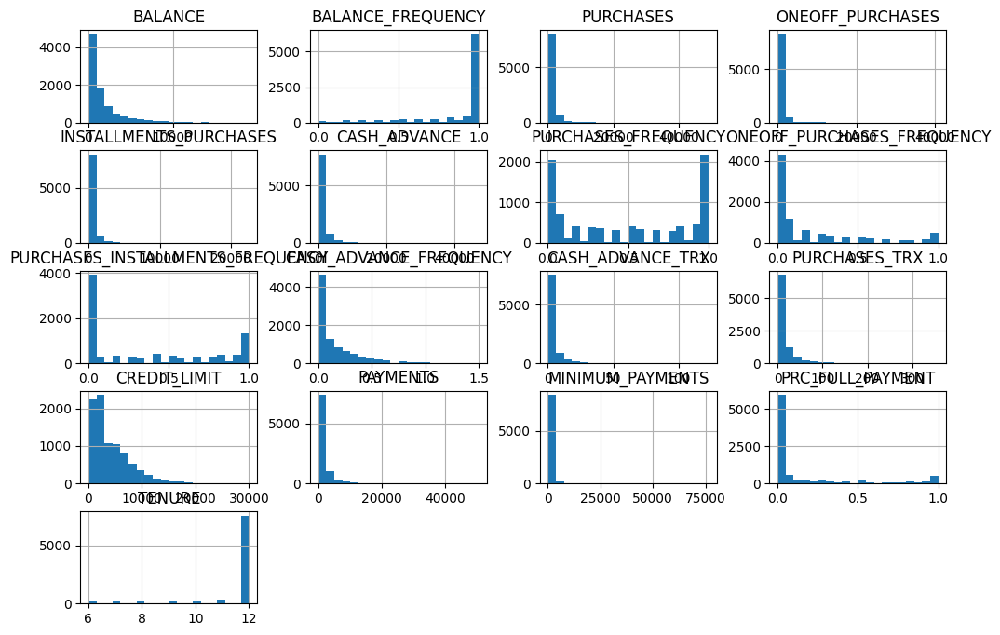

In [17]:
df.hist(figsize=[12, 8], bins = 20)

все признаки кажутся значимыми, кроме CUST_ID
ONEOFF_PURCHASES - кол-во покупок за раз, не очень большая дисперсия и странный признок
MINIMUM_PAYMENTS - тоже кажется не информативно
TENURE - по идее не важно как давно у пользователя карта, он мог ее обновить недавно
PURCHASES_TRX - у нас есть частота, суммы

In [18]:
df = df.drop(columns=["CUST_ID",'PURCHASES_TRX','TENURE','MINIMUM_PAYMENTS','ONEOFF_PURCHASES'] )

Посмотрим на корреляцию, может мы можем что то убрать(оставить один из скорелированных признаков)
>0.9 у:
PURCHASES_FREQUENCY и PURCHASESINSTALLMENTSFREQUENCY, удалим так PURCHASESINSTALLMENTSFREQUENCY как уже есть INSTALLMENTS_PURCHASES
PURCHASESINSTALLMENTSFREQUENCY и PURCHASES_FREQUENCY, PURCHASESINSTALLMENTSFREQUENCY - уже удалили
у CASHADVANCEFREQUENCY и CASHADVANCETRX 0.8, оставим CASHADVANCETRX

<Axes: >

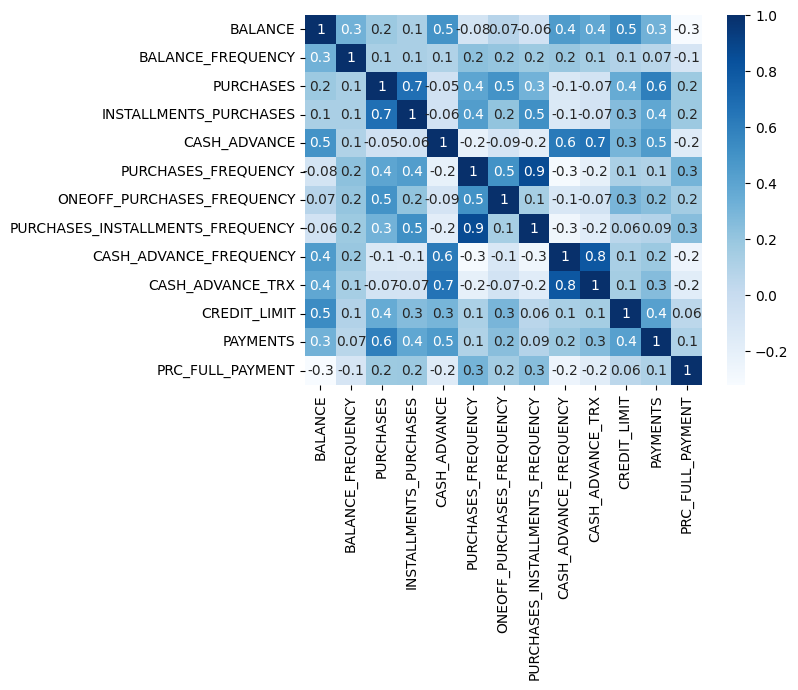

In [28]:
import seaborn as sb
corr = df.corr()
sb.heatmap(corr, cmap="Blues", annot=True, fmt = ".1g")

In [19]:
df = df.drop(columns=['PURCHASES_INSTALLMENTS_FREQUENCY','CASH_ADVANCE_FREQUENCY'])
df

,BALANCE,BALANCE_FREQUENCY,PURCHASES,INSTALLMENTS_PURCHASES,CASH_ADVANCE,PURCHASES_FREQUENCY,ONEOFF_PURCHASES_FREQUENCY,CASH_ADVANCE_TRX,CREDIT_LIMIT,PAYMENTS,PRC_FULL_PAYMENT
0,40.900749,0.818182,95.40,95.40,0.000000,0.166667,0.000000,0,1000.0,201.802084,0.000000
1,3202.467416,0.909091,0.00,0.00,6442.945483,0.000000,0.000000,4,7000.0,4103.032597,0.222222
2,2495.148862,1.000000,773.17,0.00,0.000000,1.000000,1.000000,0,7500.0,622.066742,0.000000
3,1666.670542,0.636364,1499.00,0.00,205.788017,0.083333,0.083333,1,7500.0,0.000000,0.000000
4,817.714335,1.000000,16.00,0.00,0.000000,0.083333,0.083333,0,1200.0,678.334763,0.000000
...,...,...,...,...,...,...,...,...,...,...,...
8945,28.493517,1.000000,291.12,291.12,0.000000,1.000000,0.000000,0,1000.0,325.594462,0.500000
8946,19.183215,1.000000,300.00,300.00,0.000000,1.000000,0.000000,0,1000.0,275.861322,0.000000
8947,23.398673,0.833333,144.40,144.40,0.000000,0.833333,0.000000,0,1000.0,81.270775,0.250000
8948,13.457564,0.833333,0.00,0.00,36.558778,0.000000,0.000000,2,500.0,52.549959,0.250000


In [20]:
df = (df - df.mean())/df.std()
df

,BALANCE,BALANCE_FREQUENCY,PURCHASES,INSTALLMENTS_PURCHASES,CASH_ADVANCE,PURCHASES_FREQUENCY,ONEOFF_PURCHASES_FREQUENCY,CASH_ADVANCE_TRX,CREDIT_LIMIT,PAYMENTS,PRC_FULL_PAYMENT
0,-0.731948,-0.249421,-0.424876,-0.349059,-0.466759,-0.806445,-0.678623,-0.476043,-0.960326,-0.528949,-0.525522
1,0.786917,0.134317,-0.469526,-0.454551,2.605459,-1.221690,-0.678623,0.110068,0.688562,0.818596,0.234214
2,0.447110,0.518055,-0.107662,-0.454551,-0.466759,1.269772,2.673302,-0.476043,0.825969,-0.383783,-0.525522
3,0.049096,-1.016896,0.232045,-0.454551,-0.368633,-1.014069,-0.399297,-0.329515,0.825969,-0.598655,-0.525522
4,-0.358755,0.518055,-0.462037,-0.454551,-0.466759,-1.014069,-0.399297,-0.476043,-0.905363,-0.364347,-0.525522
...,...,...,...,...,...,...,...,...,...,...,...
8945,-0.737909,0.518055,-0.333274,-0.132636,-0.466759,1.269772,-0.678623,-0.476043,-0.960326,-0.486189,1.183885
8946,-0.742382,0.518055,-0.329118,-0.122817,-0.466759,1.269772,-0.678623,-0.476043,-0.960326,-0.503368,-0.525522
8947,-0.740357,-0.185466,-0.401943,-0.294876,-0.466759,0.854528,-0.678623,-0.476043,-0.960326,-0.570583,0.329182
8948,-0.745133,-0.185466,-0.469526,-0.454551,-0.449327,-1.221690,-0.678623,-0.182988,-1.097733,-0.580503,0.329182


In [21]:
df = df.dropna()

In [23]:
from sklearn.cluster import KMeans
model = KMeans(n_clusters=5)
model_labels = model.fit_predict(df)

/Users/21311064/Library/Python/3.10/lib/python/site-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


/var/folders/p1/8s9_fqq533b0tkl0412p4btrr53559/T/ipykernel_11881/104839866.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['clusters'] = model_labels


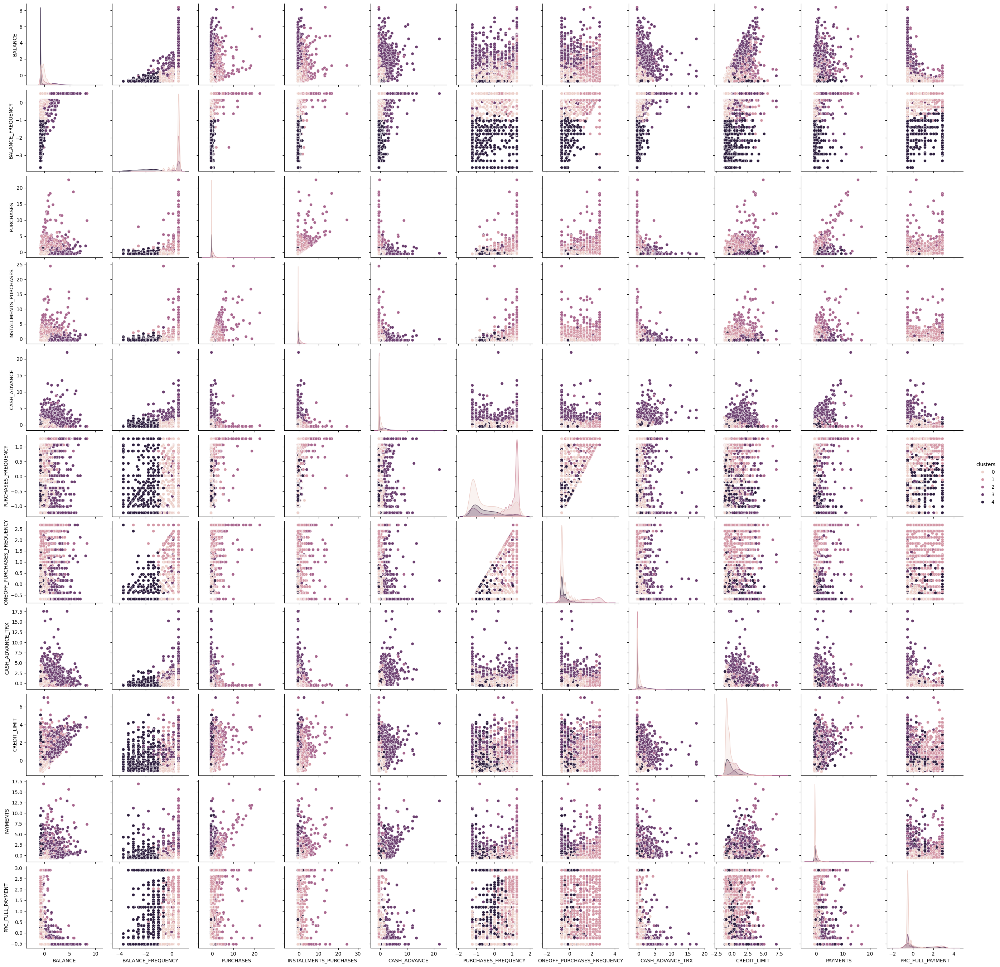

In [34]:
df['clusters'] = model_labels
sb.pairplot(df, hue = "clusters")

<Axes: xlabel='pc_1', ylabel='pc_2'>

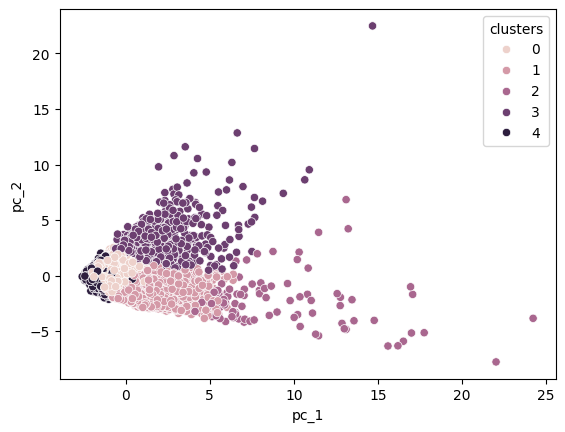

In [38]:
df = df.drop(columns="clusters")
from sklearn.decomposition import PCA
pca = PCA(n_components=2, whiten=False, random_state=42)
authors_standardized_pca = pca.fit_transform(df)
df_authors_standardized_pca = pd.DataFrame(data=authors_standardized_pca, columns=["pc_1", "pc_2"])
df_authors_standardized_pca["clusters"] = model_labels
sb.scatterplot(x="pc_1", y="pc_2", hue="clusters", data=df_authors_standardized_pca)

по парным гистограммам и проекции видно, что 5 кластеров маловато

2

In [24]:
from sklearn.cluster import DBSCAN
clustering_DBSCAN = DBSCAN(eps=0.5, min_samples=5).fit(df).labels_

/var/folders/p1/8s9_fqq533b0tkl0412p4btrr53559/T/ipykernel_29910/2004337429.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['clusters'] = clustering_DBSCAN


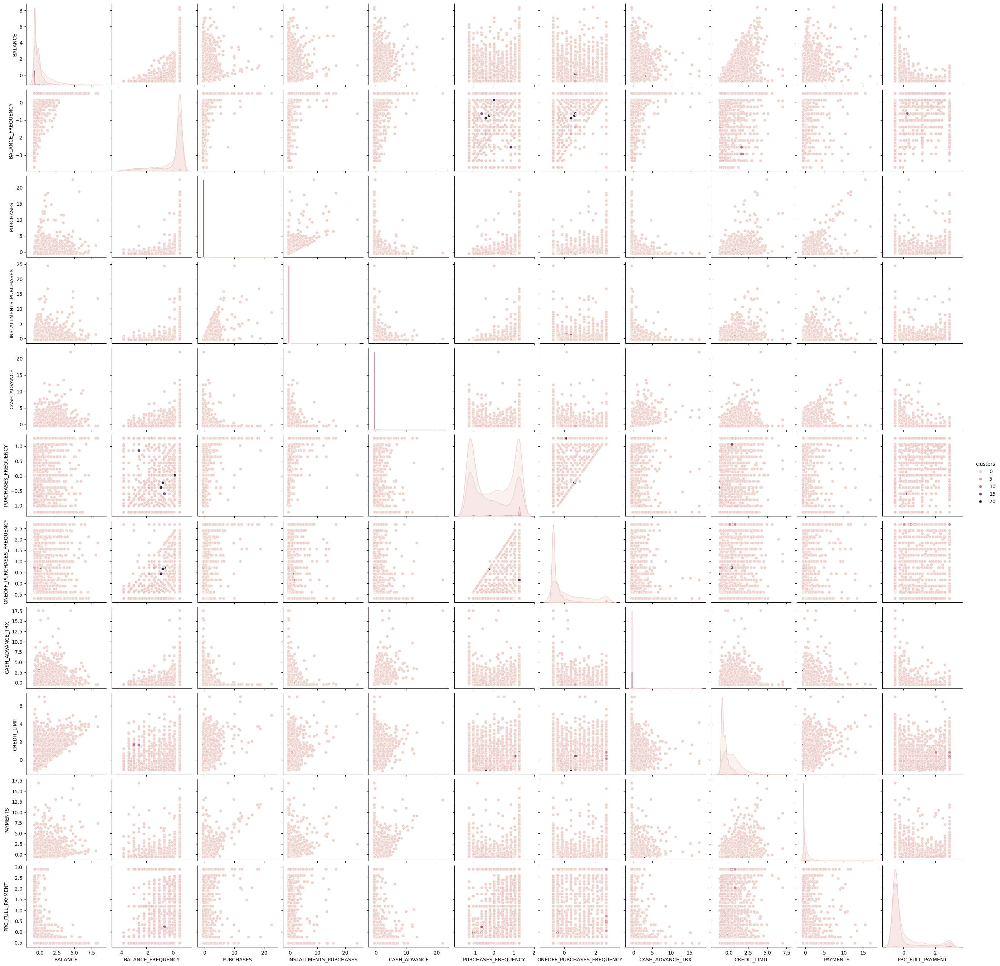

In [25]:
df['clusters'] = clustering_DBSCAN
sb.pairplot(df, hue = "clusters")

увеличим eps и min_samples

/var/folders/p1/8s9_fqq533b0tkl0412p4btrr53559/T/ipykernel_29910/2297737564.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['clusters'] = clustering_DBSCAN


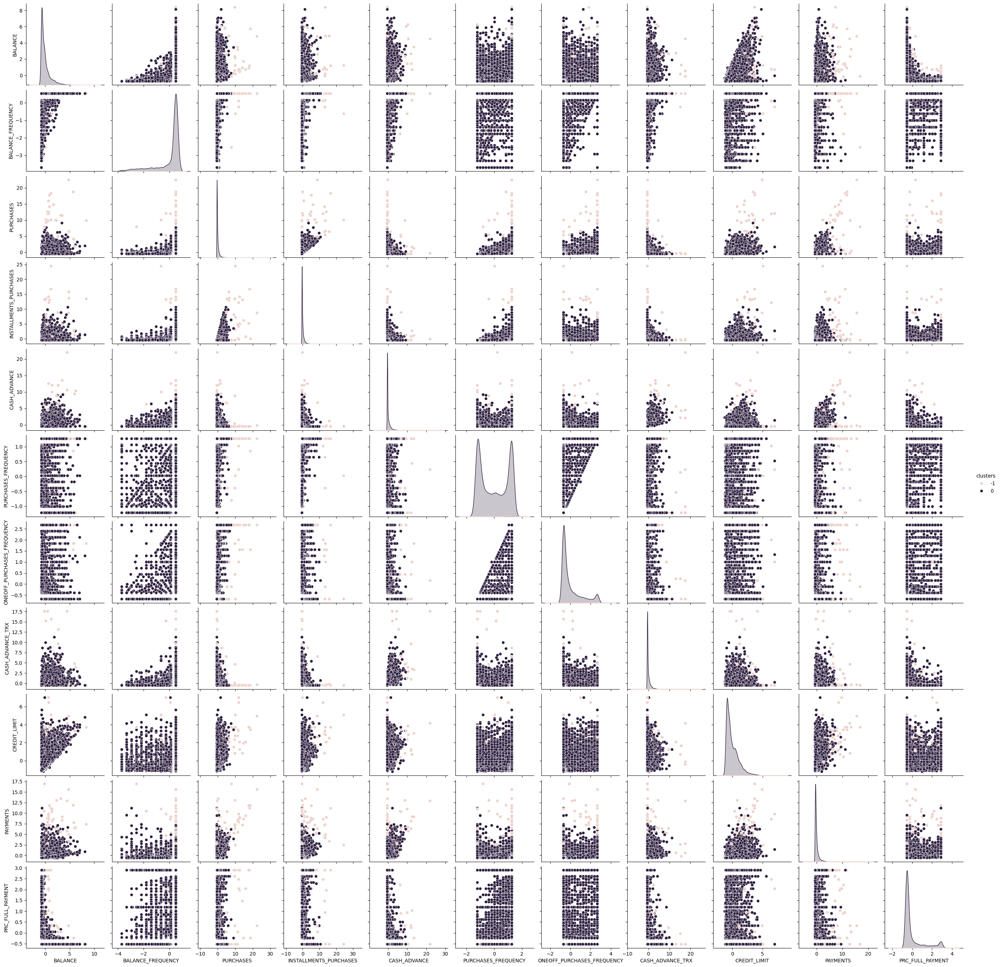

In [26]:
from sklearn.cluster import DBSCAN
clustering_DBSCAN = DBSCAN(eps=5, min_samples=15).fit(df.drop(columns = 'clusters')).labels_
df['clusters'] = clustering_DBSCAN
sb.pairplot(df, hue = "clusters")

мало кластеров, уменьшим min_samples и eps

/var/folders/p1/8s9_fqq533b0tkl0412p4btrr53559/T/ipykernel_29910/2033964276.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['clusters'] = clustering_DBSCAN


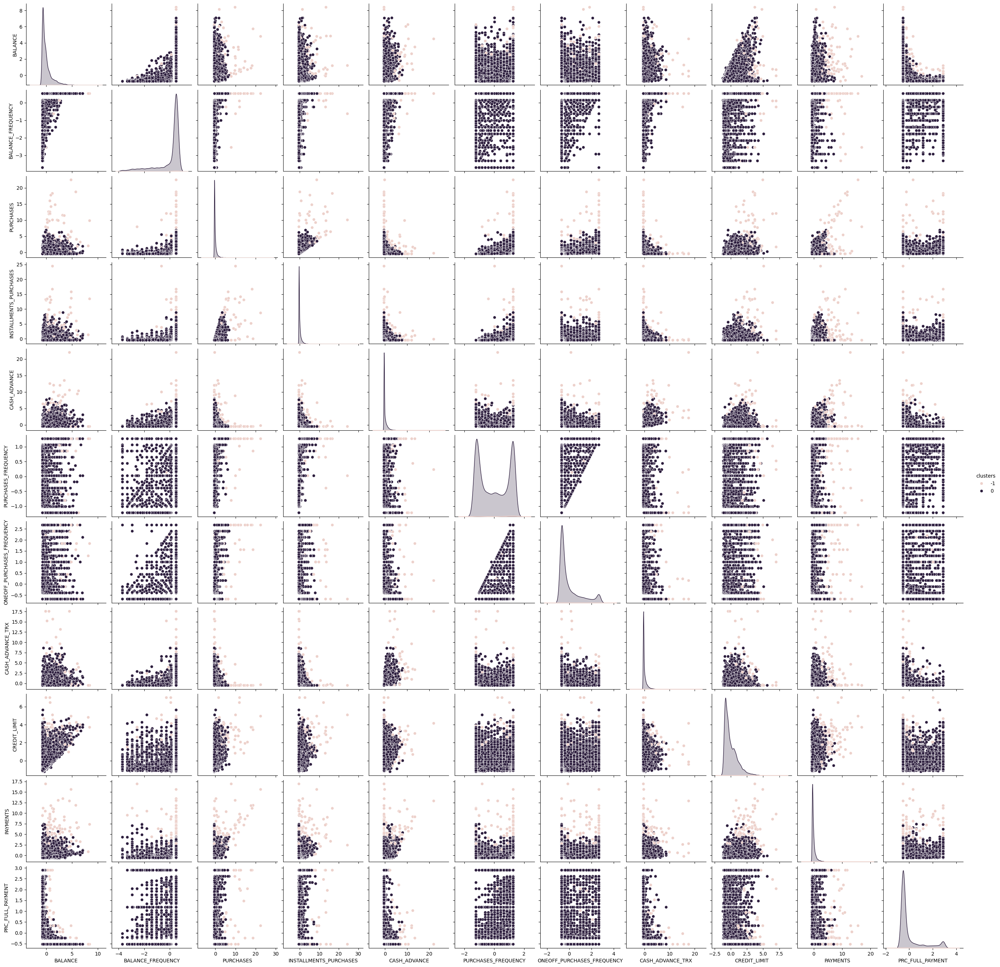

In [27]:
from sklearn.cluster import DBSCAN
clustering_DBSCAN = DBSCAN(eps=3, min_samples=8).fit(df.drop(columns = 'clusters')).labels_
df['clusters'] = clustering_DBSCAN
sb.pairplot(df, hue = "clusters")

/Users/21311064/Library/Python/3.10/lib/python/site-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)
/var/folders/p1/8s9_fqq533b0tkl0412p4btrr53559/T/ipykernel_29910/2608746593.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['clusters'] = model_labels


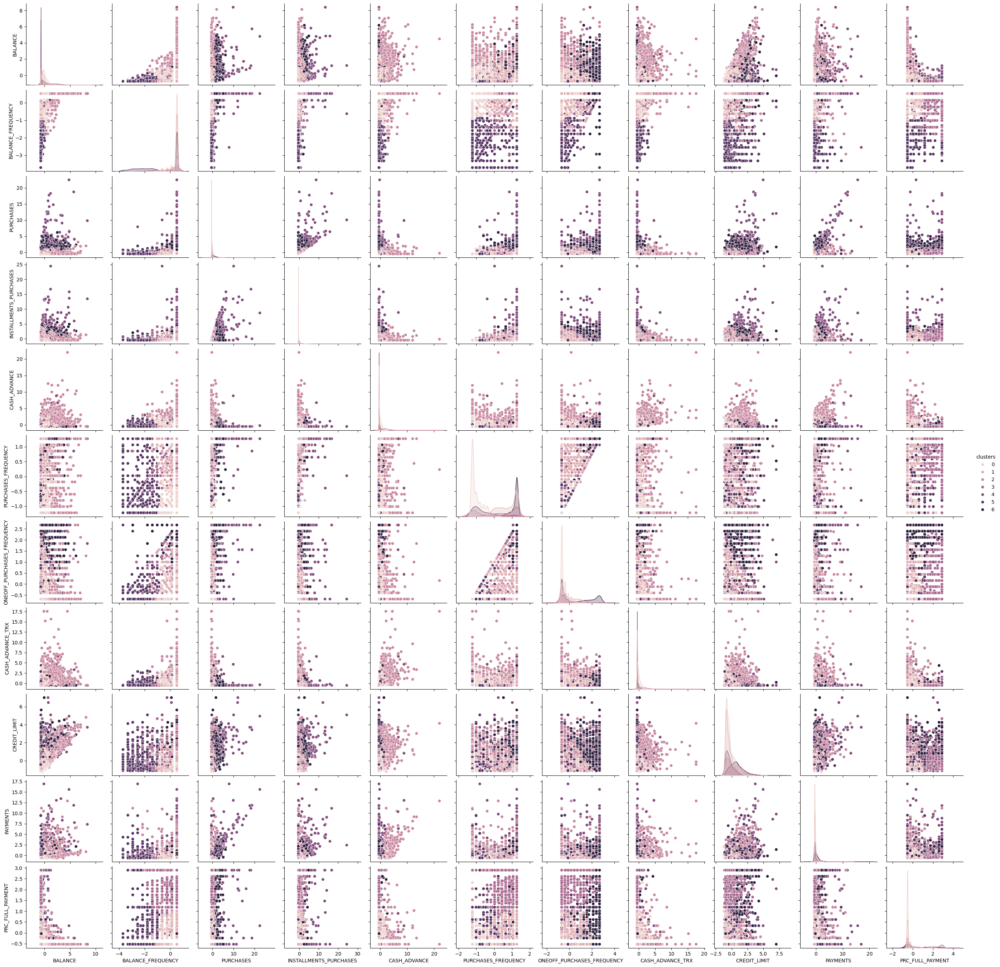

In [28]:
model = KMeans(n_clusters=7)
model_labels = model.fit_predict(df.drop(columns = 'clusters'))
df['clusters'] = model_labels
sb.pairplot(df, hue = "clusters")

/Users/21311064/Library/Python/3.10/lib/python/site-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)
/var/folders/p1/8s9_fqq533b0tkl0412p4btrr53559/T/ipykernel_29910/4175444293.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['clusters'] = model_labels


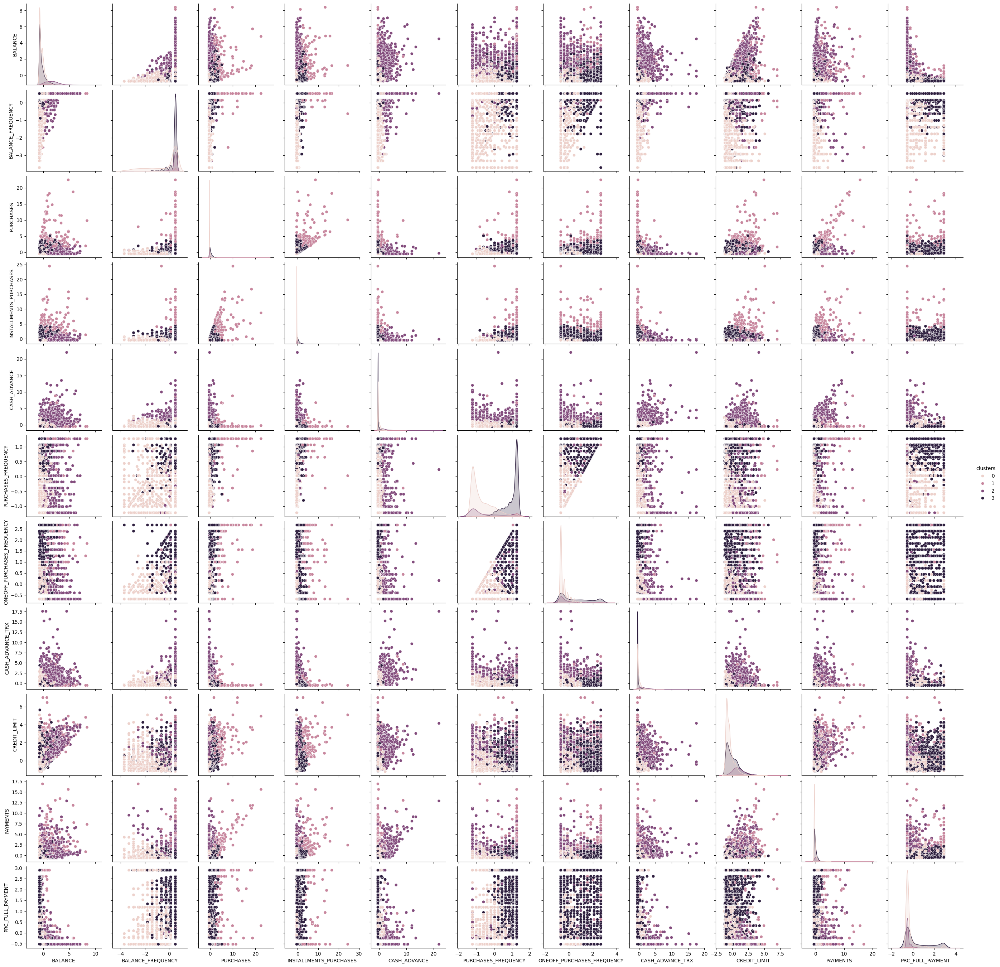

In [29]:
model = KMeans(n_clusters=4)
model_labels = model.fit_predict(df.drop(columns = 'clusters'))
df['clusters'] = model_labels
sb.pairplot(df, hue = "clusters")

4 кластера k-means выглядят лучше всего, фича BALANCE разделяется с другими более менее хорошо, кроме PURCHASES_FREQUENCY, ONEOFFPURCHASESFREQUENCY
PURCHASES тоже разделяяется хорошо
PRCFULLPAYMENT много выбросов
CASH_ADVANCE как будто 1 кластер
